# ELL Massachusetts Data
Niamh Murphy
---
My project centers around a sample from the Massachusetts Education Department's English language learning scores data from the K - 12th Grade ACCESS tests and the 8th - 10th Science Subject MCAS tests.




# Initialize Notebook

Install and load python libraries

In [1]:
%pip install censusdata 
%pip install geopandas
%pip install folium -U
%pip install mapclassify
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
import plotly.express as px
import censusdata 
import geopandas as gpd
import folium
import datetime
import scipy
from scipy import stats
from urllib.request import urlopen
from io import BytesIO
from zipfile import ZipFile
from pathlib import Path
%matplotlib inline 

     |████████████████████████████████| 26.6 MB 20.9 MB/s 
  Created wheel for censusdata: filename=CensusData-1.15.post1-py3-none-any.whl size=28205763 sha256=5459073cacdd0d6d8af3b4834c4c1e870108685b62217d442ee0bc05640f2b9d
  Stored in directory: /root/.cache/pip/wheels/2f/72/16/5c8e185711751db7fa81da8c6329c8b3d82c0582a51a0f1e85
Successfully built censusdata
     |████████████████████████████████| 1.0 MB 26.6 MB/s 
     |████████████████████████████████| 16.7 MB 45.1 MB/s 
     |████████████████████████████████| 6.3 MB 54.7 MB/s 
     |████████████████████████████████| 95 kB 4.5 MB/s 
  Attempting uninstall: folium
    Found existing installation: folium 0.8.3
    Uninstalling folium-0.8.3:
      Successfully uninstalled folium-0.8.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.12.1.post1 whic

Loading Grade 8 MCAS Data for 2019 Dual Language and Transitional Bilingual schools

In [2]:
MCAS_2019_GRADE8_DLTB_URL = 'http://citelms.net/Classes/DataAnalytics/data/Data%20Analytics%20Capstone/Copy%20of%202019%20-%20Sheet%20%2332%20-%20Grade%208%20MCAS%20Scores%20for%20Dual%20Language%20(DL)%20or%20Transitional%20Bilingual%20(TB).xlsx'

mcas_2019_grade8_dltb = pd.read_excel(MCAS_2019_GRADE8_DLTB_URL,header=1)

mcas_2019_grade8_dltb.head()

,School Name,School Code,Subject,M+E #,M+E %,E #,E %,M #,M %,PM #,PM %,NM #,NM %,No. of Students Included,Avg. Scaled Score,Avg.SGP,Included In Avg.SGP,Ach. PCTL
0,Boston - Hurley K-8 School,350182.0,ELA,6.0,50.0,0.0,0.0,6.0,50.0,6.0,50.0,0.0,0.0,12.0,499.5,NaN,12.0,98.0
1,Boston - Hurley K-8 School,350182.0,MATH,2.0,17.0,0.0,0.0,2.0,17.0,10.0,83.0,0.0,0.0,12.0,487.4,NaN,12.0,91.0
2,Boston - Hurley K-8 School,350182.0,SCI,0.0,0.0,0.0,0.0,0.0,0.0,9.0,75.0,3.0,25.0,12.0,476.3,NaN,NaN,84.0
3,Boston - Mario Umana Academy,350656.0,ELA,2.0,3.0,0.0,0.0,2.0,3.0,23.0,36.0,39.0,61.0,64.0,466.4,45.4,55.0,43.0
4,Boston - Mario Umana Academy,350656.0,MATH,1.0,2.0,0.0,0.0,1.0,2.0,26.0,41.0,36.0,57.0,63.0,470.9,39.5,55.0,36.0


Loading Grade 8 MCAS Data for 2019 Sheltered English Immersion schools

In [3]:
MCAS_2019_GRADE8_SEI_URL = 'http://citelms.net/Classes/DataAnalytics/data/Data%20Analytics%20Capstone/Copy%20of%202019%20-%20Sheet%20%2335%20-%20Grade%208%20MCAS%20Scores%20for%20SEI%20Programs.xlsx'

mcas_2019_grade8_sei = pd.read_excel(MCAS_2019_GRADE8_SEI_URL,header=1)

mcas_2019_grade8_sei.head()

/usr/local/lib/python3.7/dist-packages/openpyxl/worksheet/_reader.py:312: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)


,School Name,School Code,Subject,M+E #,M+E %,E #,E %,M #,M %,PM #,PM %,NM #,NM %,No. of Students Included,Avg. Scaled Score,Avg.SGP,Included In Avg.SGP,Ach. PCTL
0,Academy Of the Pacific Rim Charter Public (Dis...,4120530.0,ELA,0.0,0.0,0.0,0.0,0.0,0.0,8.0,73.0,3.0,27.0,11.0,475.4,NaN,9.0,79.0
1,Academy Of the Pacific Rim Charter Public (Dis...,4120530.0,MATH,0.0,0.0,0.0,0.0,0.0,0.0,8.0,73.0,3.0,27.0,11.0,474.3,NaN,8.0,52.0
2,Academy Of the Pacific Rim Charter Public (Dis...,4120530.0,SCI,0.0,0.0,0.0,0.0,0.0,0.0,7.0,64.0,4.0,36.0,11.0,471.5,NaN,NaN,65.0
3,Advanced Math and Science Academy Charter (Dis...,4300305.0,ELA,1.0,10.0,0.0,0.0,1.0,10.0,8.0,80.0,1.0,10.0,10.0,481.8,NaN,10.0,89.0
4,Advanced Math and Science Academy Charter (Dis...,4300305.0,MATH,0.0,0.0,0.0,0.0,0.0,0.0,8.0,80.0,2.0,20.0,10.0,478.6,NaN,10.0,72.0


Loading Grade 10 MCAS Data for 2019 Dual Language and Transitional Bilingual schools

In [4]:
MCAS_2019_GRADE10_DLTB_URL = 'http://citelms.net/Classes/DataAnalytics/data/Data%20Analytics%20Capstone/%202019%20-%20Sheet%20%232%20-%20Grade%2010%20MCAS%20Scores%20for%20Dual%20Language%20(DL)%20or%20Transitional%20Bilingual%20(TB)_.xlsx'

mcas_2019_grade10_dltb = pd.read_excel(MCAS_2019_GRADE10_DLTB_URL)

mcas_2019_grade10_dltb.head()

,School Name,School Code,Subject,P+A #,P+A %,A #,A %,P #,P %,NI #,NI %,W/F #,W/F %,Student Included,CPI,Ave. SGP,Included In Ave. SGP
0,Boston - Margarita Muniz Academy,350549,SCI,0,0,0,0,0,0,22,85,4,15,26,50.0,NaN,NaN
1,Brockton - Brockton High,440505,SCI,28,17,2,1,26,16,74,46,60,37,162,57.1,NaN,NaN
2,Framingham - Framingham High School,1000515,SCI,6,19,0,0,6,19,15,48,10,32,31,61.3,NaN,NaN
3,Boston - Margarita Muniz Academy,350549,PHY,7,17,1,2,6,15,16,39,18,44,41,NaN,NaN,NaN
4,Brockton - Brockton High,440505,BIO,32,18,4,2,28,16,76,43,68,39,176,NaN,NaN,NaN


Loading Grade 10 MCAS Data for 2019 Sheltered English Immersion schools

In [5]:
MCAS_2019_GRADE10_SEI_URL = 'http://citelms.net/Classes/DataAnalytics/data/Data%20Analytics%20Capstone/2019%20-%20Sheet%20%235%20-%20Grade%2010%20MCAS%20Scores%20for%20SEI%20Programs.xlsx'

mcas_2019_grade10_sei = pd.read_excel(MCAS_2019_GRADE10_SEI_URL)

mcas_2019_grade10_sei.head()

/usr/local/lib/python3.7/dist-packages/openpyxl/worksheet/_reader.py:312: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)


,School Name,School Code,Subject,P+A #,P+A %,A #,A %,P #,P %,NI #,NI %,W/F #,W/F %,Student Included,Ave. SGP,Included In Ave. SGP,Unnamed: 16
0,Attleboro - Attleboro High,160505.0,SCI,0.0,0.0,0.0,0.0,0.0,0.0,7.0,64.0,4.0,36.0,11.0,40.9,NaN,NaN
1,Barnstable - Barnstable High,200505.0,SCI,0.0,0.0,0.0,0.0,0.0,0.0,3.0,25.0,9.0,75.0,12.0,33.3,NaN,NaN
2,Boston - Boston Community Leadership Academy,350558.0,SCI,1.0,5.0,0.0,0.0,1.0,5.0,8.0,38.0,12.0,57.0,21.0,39.3,NaN,NaN
3,Boston - Boston International High School,350507.0,SCI,16.0,39.0,4.0,10.0,12.0,29.0,17.0,41.0,8.0,20.0,41.0,72.0,NaN,NaN
4,Boston - Brighton High,350505.0,SCI,2.0,7.0,0.0,0.0,2.0,7.0,13.0,45.0,14.0,48.0,29.0,48.3,NaN,NaN


Loading ACCESS Grade K - 12 Test scores Data for 2019 Sheltered English Immersion schools

In [6]:
ACCESS_2019_GRADEK12_SEI_URL = 'http://citelms.net/Classes/DataAnalytics/data/Data%20Analytics%20Capstone/2019%20-%20Sheet%20%235%20-%20ACCESS%20Scores%20for%20SEI%20Programs%20schools.xlsx'

access_2019_gradek12_sei = pd.read_excel(ACCESS_2019_GRADEK12_SEI_URL)

access_2019_gradek12_sei.head()

,District Code,District Name,School Code,School Name,Grade,Years in MA Schools,# Enrolled,# Tested (Standard & Alt),Participa-tion \n Rate,# \n Taking Standard Test,...,# Level 5,% Level 5,# Level 6,% Level 6,# Included in Progress,# Making Progress,% Making Progress,# Included in Making Exit Criteria,# \n Making Exit Criteria,% Making Exit Criteria
0,10000.0,Abington,10015.0,Woodsdale Elementary School,2021-03-05 00:00:00,All,21.0,21.0,1.00,21.0,...,0.0,0.0,0.0,0.0,19.0,13.0,0.68,21.0,8.0,0.38
1,10000.0,Abington,10015.0,Woodsdale Elementary School,All,All,21.0,21.0,1.00,21.0,...,0.0,0.0,0.0,0.0,19.0,13.0,0.68,21.0,8.0,0.38
2,10000.0,Abington,10020.0,Beaver Brook Elementary,K,All,12.0,12.0,1.00,12.0,...,0.0,0.0,0.0,0.0,NaN,NaN,NaN,12.0,0.0,0.00
3,10000.0,Abington,10020.0,Beaver Brook Elementary,2021-01-02 00:00:00,All,29.0,28.0,0.97,26.0,...,0.0,0.0,0.0,0.0,24.0,12.0,0.50,29.0,4.0,0.14
4,10000.0,Abington,10020.0,Beaver Brook Elementary,All,All,41.0,40.0,0.98,38.0,...,0.0,0.0,0.0,0.0,24.0,12.0,0.50,41.0,4.0,0.10


Loading ACCESS Grade K - 12 Test scores Data for 2019 Dual Language and Transitional Bilingual schools

In [7]:
ACCESS_2019_GRADEK12_DLTB_URL = 'http://citelms.net/Classes/DataAnalytics/data/Data%20Analytics%20Capstone/2019%20-%20Sheet%20%232%20-%20ACCESS%20Scores%20for%20Dual%20Language%20(DL)%20or%20Transitional%20Bilingual%20(TB)%20schools%20.xlsx'

access_2019_gradek12_dltb = pd.read_excel(ACCESS_2019_GRADEK12_DLTB_URL)

access_2019_gradek12_dltb.head()

,District Code,District Name,School Code,School Name,Grade,Years in MA Schools,# Enrolled,# Tested (Standard & Alt),Participa-tion \n Rate,# \n Taking Standard Test,...,# Level 5,% Level 5,# Level 6,% Level 6,# Included in Progress,# Making Progress,% Making Progress,# Included in Making Exit Criteria,# \n Making Exit Criteria,% Making Exit Criteria
0,80000.0,Amherst,80020.0,Fort River Elementary,2021-01-02 00:00:00,All,19.0,19.0,1.0,19.0,...,0.0,0.00,0.0,0.0,18.0,6.0,0.33,19.0,0.0,0.00
1,80000.0,Amherst,80020.0,Fort River Elementary,2021-03-05 00:00:00,All,18.0,18.0,1.0,18.0,...,1.0,0.06,0.0,0.0,16.0,13.0,0.81,18.0,9.0,0.50
2,80000.0,Amherst,80020.0,Fort River Elementary,All,All,46.0,46.0,1.0,46.0,...,1.0,0.02,0.0,0.0,35.0,19.0,0.54,46.0,10.0,0.22
3,350000.0,Boston,350016.0,Mattahunt Elementary School,K,All,42.0,42.0,1.0,42.0,...,1.0,0.02,0.0,0.0,NaN,NaN,NaN,42.0,1.0,0.02
4,350000.0,Boston,350016.0,Mattahunt Elementary School,2021-01-02 00:00:00,All,59.0,59.0,1.0,51.0,...,0.0,0.00,0.0,0.0,51.0,37.0,0.73,59.0,9.0,0.15


Load 2019 Massachusetts Per Pupil Expenditures

In [8]:
ma_per_pupil_expenditures_2019 = pd.read_excel('http://citelms.net/Classes/DataAnalytics/data/Data%20Analytics%20Capstone/2019-Massachusetts-PerPupilExpenditures.xlsx',header=1)
ma_per_pupil_expenditures_2019.head()

/usr/local/lib/python3.7/dist-packages/openpyxl/worksheet/_reader.py:312: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)


,District Name,District Code,In-District Expenditures,Total In-district FTEs,In-District Expenditures per Pupil,Total Expenditures,Total Pupil FTEs,Total Expenditures per Pupil
0,Abby Kelley Foster Charter Public (District),4450000,"$21,896,724.82","1,425.4","$15,361.60","$21,896,724.82","1,425.4","$15,361.60"
1,Abington,10000,"$28,935,060.43","2,064.7","$14,014.17","$32,687,048.06","2,166.7","$15,086.10"
2,Academy Of the Pacific Rim Charter Public (Dis...,4120000,"$10,728,860.94",532.7,"$20,141.29","$10,728,860.94",532.7,"$20,141.29"
3,Acton-Boxborough,6000000,"$84,437,382.26","5,586.8","$15,113.73","$93,817,043.97","5,710.8","$16,428.00"
4,Acushnet,30000,"$12,904,090.49","1,018.1","$12,674.68","$17,148,647.53","1,336.5","$12,831.01"


In [9]:
# round Total Expenditures per student to whole dollars
# taken from https://pbpython.com/currency-cleanup.html
ma_per_pupil_expenditures_2019['Total Expenditures per Pupil'] = (ma_per_pupil_expenditures_2019['Total Expenditures per Pupil'].apply(lambda x: x.replace('$', '').replace(',', '')
                                if isinstance(x, str) else x).astype(float)).round(0).astype(int)

Load the shape files to display the Massachusetts School Districts on a map

In [10]:
ma_school_districts_file_url = 'https://s3.us-east-1.amazonaws.com/download.massgis.digital.mass.gov/shapefiles/state/schooldistricts.zip'
http_response = urlopen(ma_school_districts_file_url)
zipfile = ZipFile(BytesIO(http_response.read()))
zipfile.extractall('./ma_school_districts')


#Used Statistic Function definitions

# Welch t-test
t-test where samples sizes and variances can be not equal
Given our data sets are not equal we use this test

Test if the  sei mean and  dltb mean are equal. Since the sample sizes and varinces are unequal, I will use Welch's t-test (https://pythonfordatascienceorg.wordpress.com/welch-t-test-python-pandas/) to test the hypothesis that the means are equal. 

In [11]:
# Function to run Welch's t-test taken from https://pythonfordatascienceorg.wordpress.com/welch-t-test-python-pandas/
def welch_ttest(x, y): 
    ## Welch-Satterthwaite Degrees of Freedom ##
    dof = (x.var()/x.size + y.var()/y.size)**2 / ((x.var()/x.size)**2 / (x.size-1) + (y.var()/y.size)**2 / (y.size-1))
   
    t, p = stats.ttest_ind(x, y, equal_var = False)
    
    print("\n",
          f"Welch's t-test= {t:.4f}", "\n",
          f"p-value = {p:.4f}", "\n",
          f"Welch-Satterthwaite Degrees of Freedom = {dof:.4f}","\n",
          "Decision: ","Reject the null hypothesis that means are equal" if p<0.05 else "Fail to reject the null hypothesis that means are equal"
    )

#Cohen's D Effect Size 
Quantiative measure of the difference between two means
 
Looking to see the relationship between the two means

https://www.simplypsychology.org/effect-size.html#:~:text=Cohen%20suggested%20that%20d%20%3D%200.2,if%20it%20is%20statistically%20significant.

In [12]:
#Cohen's d Effect size
def cohen_d(a,b, describe = True):
    a_n,b_n = len(a),len(b)
    #Calculate pooled standard deviation.
    pv_num = ((a_n-1)*a.var())+((b_n-1)*b.var())
    pv_den = a_n+b_n
    pooled_sd = np.sqrt(pv_num/pv_den)
    d = (a.mean()-b.mean())/pooled_sd
    if describe:
        print("Cohens'd: ",d)
        if d<0.20:
            print('Effect Size: Very Small')
        elif d<0.50:
            print('Effect Size: Small')
        elif d<0.80:
            print('Effect Size: Medium')
        else:
            print('Effect Size: Large')
    return d

#Correlation of two variables
**Three correlation tests:**


*   Pearson
*   Spearman
*   Kendall

https://www.statisticssolutions.com/free-resources/directory-of-statistical-analyses/correlation-pearson-kendall-spearman/

#Pearson

In [13]:
def pearsonr(x,y):
 correlation, p_value = scipy.stats.pearsonr(x, y)
 print("Pearson Correlation Coefficient: ", correlation)
 abs_correlation = abs(correlation)
 if abs_correlation > 0.9 :
   if correlation < 0:
     print("Very High Negative Correlation")
   else:
     print("Very High Positive Correlation")
 elif abs_correlation > 0.7:
   if correlation < 0:
     print("High Negative Correlation")
   else:
     print("High Positive Correlation")
 elif abs_correlation > 0.5:
   if correlation < 0:
     print("Moderate Negative Correlation")
   else:
     print("Moderate Positive Correlation")
 elif abs_correlation > 0.3:
   if correlation < 0:
     print("Low Negative Correlation")
   else:
     print("Low Positive Correlation")
 else:
  if correlation < 0:
     print("Negligibile Negative Correlation")
  else:
     print("Negligibile Positive Correlation")
 print(" ")
 print("Pearson P-Value: ", p_value)
 if p_value < 0.05: 
   print("Reject the null hypothesis that correlation is 0")
 else:
   print("Fail to reject the null hypothesis that correlation is 0")

# Spearman

In [14]:
def spearmanr(x,y):
 correlation, p_value = scipy.stats.spearmanr(x, y)
 print("Spearman Correlation Coefficient: ", correlation)
 abs_correlation = abs(correlation)
 if abs_correlation > 0.9 :
   if correlation < 0:
     print("Very High Negative Correlation")
   else:
     print("Very High Positive Correlation")
 elif abs_correlation > 0.7:
   if correlation < 0:
     print("High Negative Correlation")
   else:
     print("High Positive Correlation")
 elif abs_correlation > 0.5:
   if correlation < 0:
     print("Moderate Negative Correlation")
   else:
     print("Moderate Positive Correlation")
 elif abs_correlation > 0.3:
   if correlation < 0:
     print("Low Negative Correlation")
   else:
     print("Low Positive Correlation")
 else:
  if correlation < 0:
     print("Negligibile Negative Correlation")
  else:
     print("Negligibile Positive Correlation")
 print(" ")
 print("Pearson P-Value: ", p_value)
 if p_value < 0.05: 
   print("Reject the null hypothesis that the two sets of data are uncorrelated")
 else:
   print("Fail to reject the null hypothesis that the two sets of data are uncorrelated")

#Kendall

In [15]:
def kendalltau(x,y):
 tau, p_value = scipy.stats.kendalltau(x, y)
 print("Kendall Tau Coefficient: ", tau)
 abs_tau = abs(tau)
 if abs_tau > 0.9 :
   if tau < 0:
     print("Very High disagreement of dependence")
   else:
     print("Very High agreement of dependence")
 elif abs_tau > 0.7:
   if tau < 0:
     print("High disagreement of dependence")
   else:
     print("High agreement of dependence")
 elif abs_tau > 0.5:
   if tau < 0:
     print("Moderate disagreement of dependence")
   else:
     print("Moderate agreement of dependence")
 elif abs_tau > 0.3:
   if tau < 0:
     print("Low disagreement of dependence")
   else:
     print("Low agreement of dependence")
 else:
  if tau < 0:
     print("Negligibile disagreement of dependence")
  else:
     print("Negligibile eement of dependence")
 print(" ")
 print("Kendall P-Value: ", p_value)
 if p_value < 0.05: 
   print("Reject the null hypothesis that the two sets of data are not associated with each other")
 else:
   print("Fail to reject the null hypothesis that the two sets of data ot associated with each other")

#Making Maps with the data

#Mapping of Massachusetts Per Pupil Expenditure for 2019 

In [16]:
# combine CCUV and Public School district shapefiles 
# using https://stackovehttps://stackoverflow.com/questions/48874113/concat-multiple-shapefiles-via-geopandasrflow.com/questions/48874113/concat-multiple-shapefiles-via-geopandas

ma_school_districts_shapefile_data = gpd.read_file("/content/ma_school_districts/SCHOOLDISTRICTS_POLY.shp")
ma_school_districts_CCUV_shapefile_data = gpd.read_file("/content/ma_school_districts/SCHOOLDISTRICTS_CCUV_POLY.shp")
ma_school_districts_shapefile_data = ma_school_districts_shapefile_data.rename(columns ={'DISTRICT_N':'District Name'})
ma_school_districts_CCUV_shapefile_data = ma_school_districts_CCUV_shapefile_data.rename(columns ={'NAME':'District Name'})

gdf = pd.concat([ma_school_districts_shapefile_data, ma_school_districts_CCUV_shapefile_data]).pipe(gpd.GeoDataFrame)
gdf.to_file("/content/ma_school_districts/SCHOOLDISTRICTS_POLY_combined.shp")
ma_school_districts_boundary = gpd.read_file("/content/ma_school_districts/SCHOOLDISTRICTS_POLY_combined.shp")
ma_school_districts_boundary = ma_school_districts_boundary.rename(columns ={'District N':'District Name'})

ma_school_districts_boundary.sort_values(by=['District Name'], inplace=True)
ma_school_districts_boundary.reset_index(drop=True, inplace=True)
ma_school_districts_boundary.head()


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  # Remove the CWD from sys.path while we load stuff.


,ORG4CODE,ORG8CODE,District Name,DISTRICT_T,MEMBERLIST,TUITION,TUITION_GR,TUITION_TO,SUPERINTEN,START_GRAD,END_GRADE,SHAPE_AREA,SHAPE_LEN,TYPE,MEMBERS,NICKNAME,SCH8CODE,geometry
0,0550,05500000,ACCEPT Education Collaborative,None,None,None,None,None,None,None,None,6.408196e+08,165574.199993,Collaborative,"Ashland, Dover, Framingham, Franklin, Hollisto...",ACCEPT,None,"MULTIPOLYGON (((209041.433 901659.485, 209058...."
1,0445,04450000,Abby Kelley Foster Charter Public School,None,None,None,None,None,None,None,None,5.939364e+08,144248.546846,Charter,"Auburn, Leicester, Millbury, Oxford, Shrewsbur...",AKFCPS,04450105,"POLYGON ((173840.723 905986.625, 176408.503 90..."
2,0001,00010000,Abington,MuniK12,None,N,None,None,None,PK,12,2.639085e+07,24139.413120,None,None,None,None,"POLYGON ((248314.472 872355.495, 245760.093 87..."
3,0412,04120000,Academy of the Pacific Rim Charter Public School,None,None,None,None,None,None,None,None,1.303840e+08,191079.658228,Charter,Boston,APR,04120530,"MULTIPOLYGON (((235055.923 904535.935, 235064...."
4,0600,06000000,Acton-Boxborough,ReglK12,"Acton, Boxborough",N,None,None,None,PK,12,7.951612e+07,42892.696690,None,None,None,None,"POLYGON ((208385.023 919537.035, 208912.212 91..."


In [17]:
ma_school_districts_boundary = ma_school_districts_boundary.set_crs(epsg=26986)
ma_school_districts_boundary.crs

<Projected CRS: EPSG:26986>
Name: NAD83 / Massachusetts Mainland
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: United States (USA) - Massachusetts onshore - counties of Barnstable; Berkshire; Bristol; Essex; Franklin; Hampden; Hampshire; Middlesex; Norfolk; Plymouth; Suffolk; Worcester.
- bounds: (-73.5, 41.46, -69.86, 42.89)
Coordinate Operation:
- name: SPCS83 Massachusetts Mainland zone (meters)
- method: Lambert Conic Conformal (2SP)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

#Boundary Map of Massachussetts School Districts

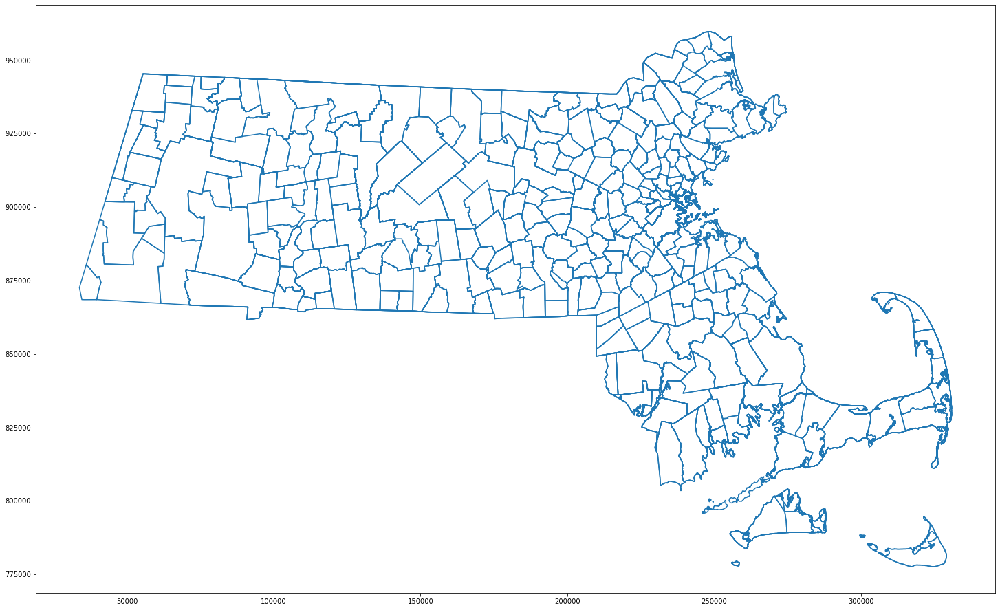

In [18]:
ma_school_districts_boundary.boundary.plot(figsize=(25,25))

#Combining geographic map data with student expenditure data

Merge Per Pupil Expenditures with boundary data

In [19]:
ma_school_district_per_pupil_expenditure_2019 = gpd.GeoDataFrame(pd.merge(ma_school_districts_boundary, ma_per_pupil_expenditures_2019, on='District Name'))


In [20]:
ma_school_district_per_pupil_expenditure_2019.head()

,ORG4CODE,ORG8CODE,District Name,DISTRICT_T,MEMBERLIST,TUITION,TUITION_GR,TUITION_TO,SUPERINTEN,START_GRAD,...,NICKNAME,SCH8CODE,geometry,District Code,In-District Expenditures,Total In-district FTEs,In-District Expenditures per Pupil,Total Expenditures,Total Pupil FTEs,Total Expenditures per Pupil
0,0001,00010000,Abington,MuniK12,None,N,None,None,None,PK,...,None,None,"POLYGON ((248314.472 872355.495, 245760.093 87...",10000,"$28,935,060.43","2,064.7","$14,014.17","$32,687,048.06","2,166.7",15086
1,0600,06000000,Acton-Boxborough,ReglK12,"Acton, Boxborough",N,None,None,None,PK,...,None,None,"POLYGON ((208385.023 919537.035, 208912.212 91...",6000000,"$84,437,382.26","5,586.8","$15,113.73","$93,817,043.97","5,710.8",16428
2,0003,00030000,Acushnet,MuniElem,None,Y,9-12,"Fairhaven, New Bedford",None,PK,...,None,None,"POLYGON ((249346.102 834852.795, 249415.703 83...",30000,"$12,904,090.49","1,018.1","$12,674.68","$17,148,647.53","1,336.5",12831
3,0603,06030000,Adams-Cheshire,ReglK12,"Adams, Cheshire",N,None,None,None,PK,...,None,None,"POLYGON ((71785.163 934421.835, 71353.392 9282...",6030000,"$18,503,004.34","1,161.6","$15,928.89","$20,868,108.53","1,396.2",14946
4,0005,00050000,Agawam,MuniK12,None,N,None,None,None,PK,...,None,None,"POLYGON ((102185.312 873555.665, 102188.042 87...",50000,"$63,234,829.14","3,710.3","$17,043.05","$69,007,740.22","3,868.8",17837


In [21]:
len(ma_school_district_per_pupil_expenditure_2019)

279

In [22]:
# clean up NaN entries 
ma_school_district_per_pupil_expenditure_2019 = ma_school_district_per_pupil_expenditure_2019.dropna(subset=['geometry', 'Total Expenditures per Pupil'])

In [23]:
# convert to lat/long for interactive mapping 
ma_school_district_per_pupil_expenditure_2019 = ma_school_district_per_pupil_expenditure_2019.to_crs(4269)

# Static Map of Massachusetts Student Expenditures

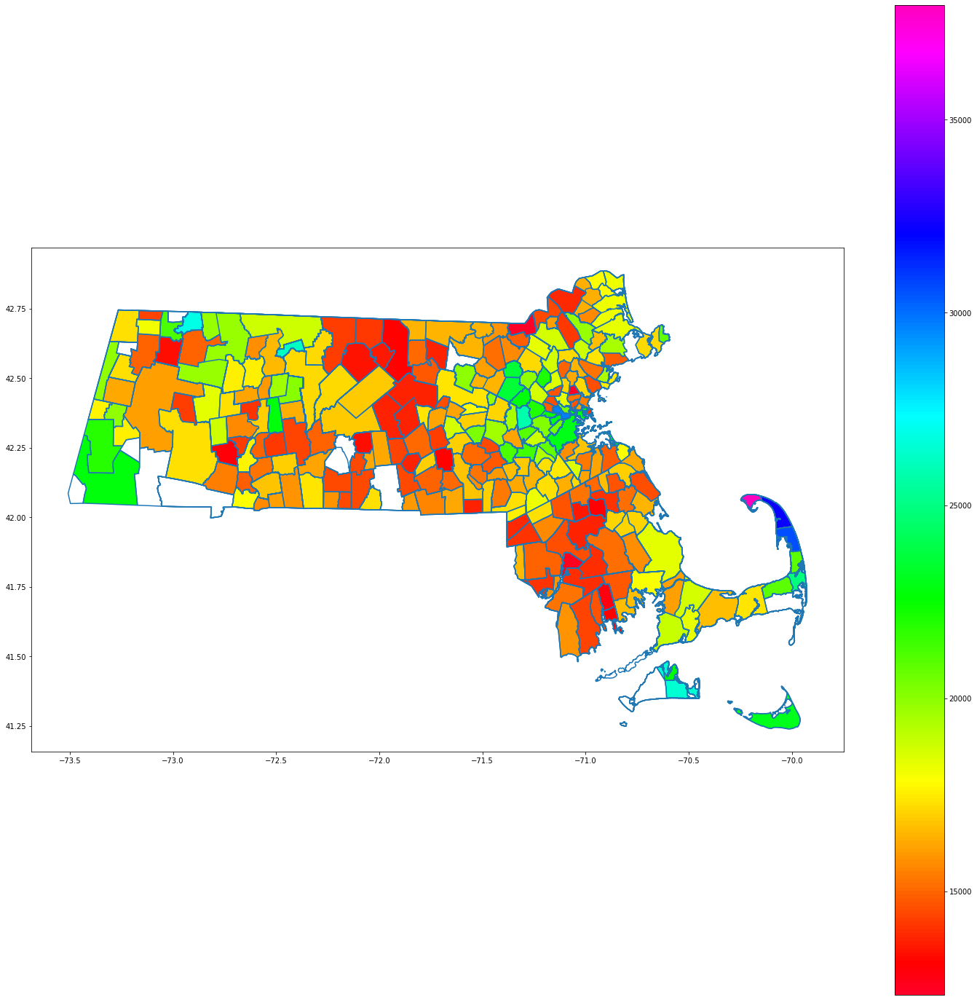

In [24]:
ma_school_districts_boundary_lat_long = ma_school_districts_boundary.to_crs(4269)
ma_school_district_per_pupil_expenditure_2019.plot( column='Total Expenditures per Pupil',  cmap='gist_rainbow', ax=ma_school_districts_boundary_lat_long.boundary.plot(figsize=(25,25)), legend=True)

#Interactive Map of Total Student Expenditures in Massachusetts

In [25]:
ma_school_district_per_pupil_expenditure_2019.explore(column='Total Expenditures per Pupil', tooltip=['District Name', 'Total Expenditures per Pupil'], cmap='gist_rainbow', legend=True)

# Demographic Data from 2019 US Census Bureau

Loading CensusData for 2019

In [26]:
massachusetts_english_non_english_speaking_by_place = censusdata.download('acs5', 2019, censusdata.censusgeo([('state', '25'), ('place', '*')]),['S1601_C01_002E', 'S1601_C01_003E'],
                                   tabletype='subject')
massachusetts_english_non_english_speaking_by_place = massachusetts_english_non_english_speaking_by_place.rename(columns={'S1601_C01_002E': 'household_english_speaking', 'S1601_C01_003E': 'household_non_english_speaking'})
massachusetts_english_non_english_speaking_by_place.head()

,household_english_speaking,household_non_english_speaking
"Weymouth Town city, Massachusetts: Summary level: 160, state:25> place:78972",45553,8443
"Winthrop Town city, Massachusetts: Summary level: 160, state:25> place:81005",13635,4064
"Belchertown CDP, Massachusetts: Summary level: 160, state:25> place:04790",2415,296
"Needham CDP, Massachusetts: Summary level: 160, state:25> place:44140",24402,4996
"Quincy city, Massachusetts: Summary level: 160, state:25> place:55745",54878,34693


In [27]:
massachusetts_median_income_by_place = censusdata.download('acs5', 2019, censusdata.censusgeo([('state', '25'), ('place', '*')]),['S1903_C03_001E'],
                                   tabletype='subject')
massachusetts_median_income_by_place = massachusetts_median_income_by_place.rename(columns={'S1903_C03_001E': 'median_income'})
massachusetts_median_income_by_place.head()

,median_income
"Weymouth Town city, Massachusetts: Summary level: 160, state:25> place:78972",84942
"Winthrop Town city, Massachusetts: Summary level: 160, state:25> place:81005",74069
"Belchertown CDP, Massachusetts: Summary level: 160, state:25> place:04790",78578
"Needham CDP, Massachusetts: Summary level: 160, state:25> place:44140",165547
"Quincy city, Massachusetts: Summary level: 160, state:25> place:55745",77562


In [28]:
massachusetts_median_income_by_place = pd.read_csv("http://citelms.net/Classes/DataAnalytics/data/Data%20Analytics%20Capstone/massachusetts_median_income_by_place.csv")
massachusetts_english_non_english_speaking_by_place = pd.read_excel("http://citelms.net/Classes/DataAnalytics/data/Data%20Analytics%20Capstone/massachusetts_english_non_english_speaking_by_place.xlsx")

In [29]:
massachusetts_english_non_english_speaking_by_place.head()

,NAME,Latitude,Longitude,english_spoken_in_home,non_english_spoken_in_home,% non_english_spoken_in_home
0,"Abington CDP, Massachusetts",42.104823,-70.945322,13971.0,1637.0,0.1049
1,"Acushnet Center CDP, Massachusetts",41.680659,-70.907816,2706.0,319.0,0.1055
2,"Adams CDP, Massachusetts",42.626981,-73.115522,4924.0,208.0,0.0405
3,"Agawam Town city, Massachusetts",42.066186,-72.648463,23501.0,3711.0,0.1364
4,"Amesbury Town city, Massachusetts",42.857954,-70.930092,15934.0,741.0,0.0444


In [30]:
massachusetts_median_income_by_place.head()

,NAME,Median Income (Dollars)
0,"Abington CDP, Massachusetts",99381
1,"Acushnet Center CDP, Massachusetts",81375
2,"Adams CDP, Massachusetts",48252
3,"Agawam Town city, Massachusetts",68944
4,"Amesbury Town city, Massachusetts",82468


Download shape files that can display maps for Massachusetts Census Designated Place ACS information
(code taken from Internet)

In [31]:
us_state_file_url = 'https://www2.census.gov/geo/tiger/GENZ2019/shp/cb_2019_us_state_500k.zip'
http_response = urlopen(us_state_file_url)
zipfile = ZipFile(BytesIO(http_response.read()))
zipfile.extractall('./cb_2019_us_state_500k')
ma_places_file_url = 'https://www2.census.gov/geo/tiger/GENZ2019/shp/cb_2019_25_place_500k.zip'
http_response = urlopen(ma_places_file_url)
zipfile = ZipFile(BytesIO(http_response.read()))
zipfile.extractall('./cb_2019_25_place_500k')

us_states_cartographic_boundary = gpd.read_file('./cb_2019_us_state_500k/cb_2019_us_state_500k.shp')
massachusetts_state = us_states_cartographic_boundary[us_states_cartographic_boundary['NAME'] == 'Massachusetts']

massachusetts_cbps_boundaries_with_median_income = gpd.read_file('./cb_2019_25_place_500k/cb_2019_25_place_500k.shp')
massachusetts_cbps_boundaries_with_median_income.sort_values(by=['NAME'], inplace=True)
massachusetts_cbps_boundaries_with_median_income.reset_index(drop=True, inplace=True)

massachusetts_cbps_boundaries_with_percent_non_english_speaking_households = gpd.read_file('./cb_2019_25_place_500k/cb_2019_25_place_500k.shp')
massachusetts_cbps_boundaries_with_percent_non_english_speaking_households.sort_values(by=['NAME'], inplace=True)
massachusetts_cbps_boundaries_with_percent_non_english_speaking_households.reset_index(drop=True, inplace=True)



Append columns of ACS data to shape files (median income)

In [32]:
massachusetts_cbps_boundaries_with_median_income['median_income'] = massachusetts_median_income_by_place['Median Income (Dollars)']
massachusetts_cbps_boundaries_with_median_income.head()

,STATEFP,PLACEFP,PLACENS,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,median_income
0,25,00135,02377975,1600000US2500135,2500135,Abington,57,25796030,594787,"POLYGON ((-71.00215 42.12730, -70.98127 42.135...",99381
1,25,00530,02377976,1600000US2500530,2500530,Acushnet Center,57,3665198,75869,"POLYGON ((-70.91900 41.68543, -70.91671 41.688...",81375
2,25,00590,02377977,1600000US2500590,2500590,Adams,57,5859625,66047,"POLYGON ((-73.13679 42.62240, -73.13402 42.629...",48252
3,25,00840,00618180,1600000US2500840,2500840,Agawam Town,25,60400819,2611581,"POLYGON ((-72.71312 42.03891, -72.71246 42.041...",68944
4,25,01260,00618292,1600000US2501260,2501260,Amesbury Town,25,31836417,3729019,"POLYGON ((-70.99744 42.86425, -70.99724 42.864...",82468


Clean up entries that are not there 

In [33]:
massachusetts_cbps_boundaries_with_median_income.drop(massachusetts_cbps_boundaries_with_median_income.index[massachusetts_cbps_boundaries_with_median_income['median_income'] == -666666666
], inplace=True)

Append columns of ACS data to shape files (percent_non_english_speaking_households)

In [34]:
massachusetts_cbps_boundaries_with_percent_non_english_speaking_households['percent_non_english_speaking_households'] = massachusetts_english_non_english_speaking_by_place['% non_english_spoken_in_home']
massachusetts_cbps_boundaries_with_percent_non_english_speaking_households.head()

,STATEFP,PLACEFP,PLACENS,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,percent_non_english_speaking_households
0,25,00135,02377975,1600000US2500135,2500135,Abington,57,25796030,594787,"POLYGON ((-71.00215 42.12730, -70.98127 42.135...",0.1049
1,25,00530,02377976,1600000US2500530,2500530,Acushnet Center,57,3665198,75869,"POLYGON ((-70.91900 41.68543, -70.91671 41.688...",0.1055
2,25,00590,02377977,1600000US2500590,2500590,Adams,57,5859625,66047,"POLYGON ((-73.13679 42.62240, -73.13402 42.629...",0.0405
3,25,00840,00618180,1600000US2500840,2500840,Agawam Town,25,60400819,2611581,"POLYGON ((-72.71312 42.03891, -72.71246 42.041...",0.1364
4,25,01260,00618292,1600000US2501260,2501260,Amesbury Town,25,31836417,3729019,"POLYGON ((-70.99744 42.86425, -70.99724 42.864...",0.0444


# Maps of Massachusetts ACS census Data for 2019 

#Static Map 2019 Massaschusetts Census Designated Place (CDP)  Median Incomes

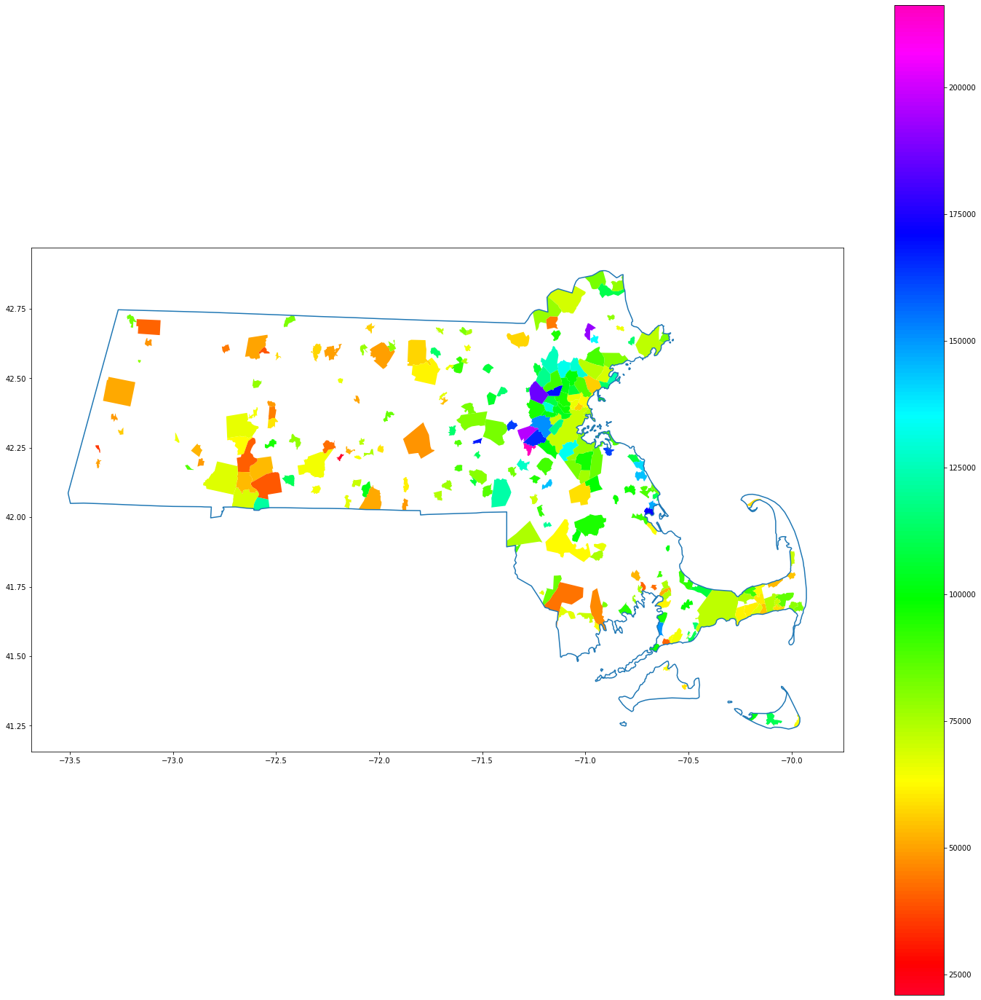

In [35]:
massachusetts_state_boundary = massachusetts_state.boundary.plot(figsize=(25, 25))
massachusetts_cbps_boundaries_with_median_income.plot(column='median_income', ax=massachusetts_state_boundary, cmap='gist_rainbow', legend=True)

#Static Map 2019 Massaschusetts Census Designated Place (CDP) percent of household that non-english speaking

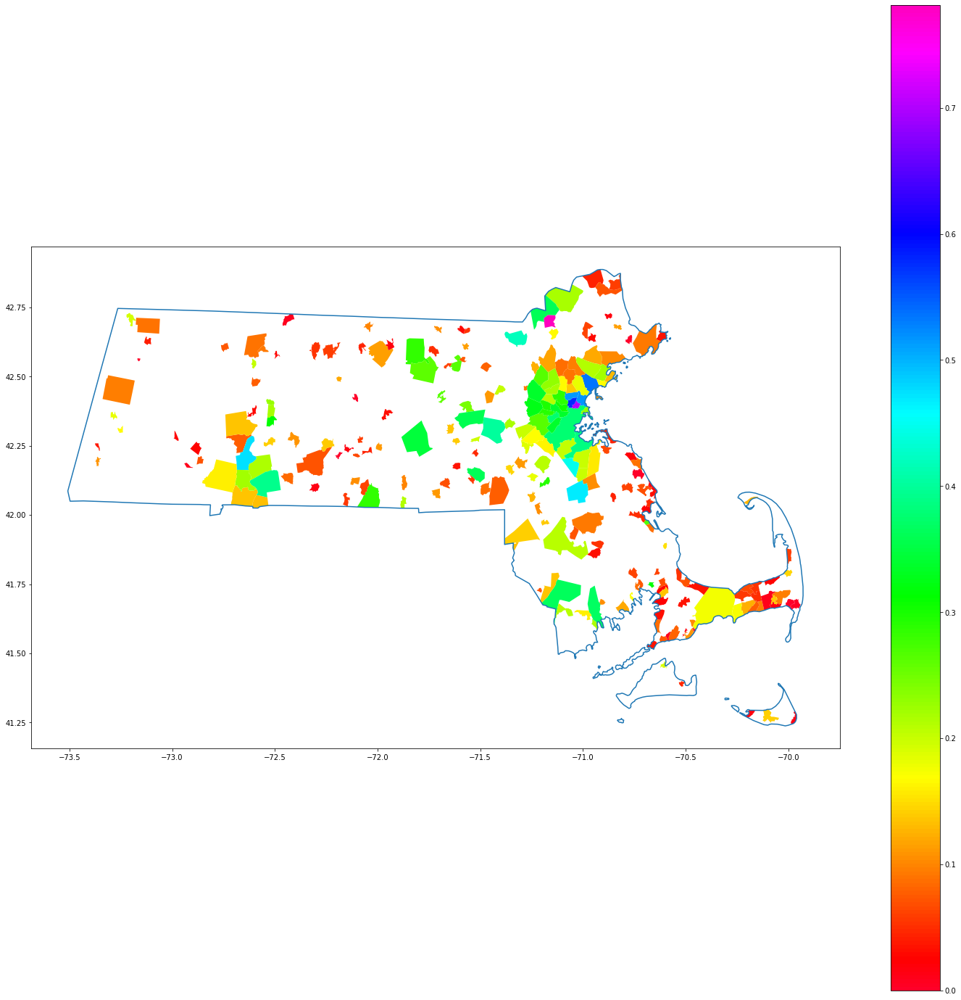

In [36]:
massachusetts_state_boundary = massachusetts_state.boundary.plot(figsize=(25, 25))
massachusetts_cbps_boundaries_with_percent_non_english_speaking_households.plot(column='percent_non_english_speaking_households', cmap='gist_rainbow', ax=massachusetts_state_boundary, legend=True)

#Interactive Map of 2019 Massaschusetts Census Designated Place (CDP) Median Incomes. Hover over color gives name and median income

In [37]:

massachusetts_cbps_boundaries_with_median_income.explore(column='median_income',  tooltip=['NAME', 'median_income'],cmap='gist_rainbow', legend=True)

#Interactive Map of 2019 Massaschusetts Census Designated Place (CDP) Percentage Households that are non-english speaking. Hover over color gives name and percentage

In [38]:
massachusetts_cbps_boundaries_with_percent_non_english_speaking_households.explore(column='percent_non_english_speaking_households', tooltip=['NAME', 'percent_non_english_speaking_households'],cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)


#ELL Data Initial Questions:
----
1. Overarching question: Do ELL students do better in Bilingual schools (Dual Language DL or Transitional Bilingual TB) or English only schools (SEI - Sheltered English Immersion)?





2. In the ACCESS (ELL test) scores data for 2019, compare Making Progress % (column Y) between the Dual/Bilingual and SEI sheets to see which has higher averages. Dr. Imeh has found that SEI schools do better, but feels there are other factors.  

  *  Does the grade (column E) or level of English 1-3 vs. 4-6 affect Making Progress % (column Y)? Look for correlation patterns.
  
  *   Does the District (column B) affect Making Progress %? Do some districts do better than others? It could be related to district wealth. Could look up per pupil expenditures.



3. Do the MCAS scores data for 2019 show similar patterns?

  *   Do the grade 10 MCAS scores have a higher passing P+A% (column E) in the dual/bilingual schools or the SEI schools? 
  
  *   Do the grade 8  MCAS scores have a higher passing M+E% (column E) in the dual/bilingual schools or the SEI schools? 



# Data Analysis and Hypothesis Testing for Initial Questions

##Extract All and Grade Scores and determine mean of % Making Progress for SEI and DLTB

Use Welch's t-test and Cohen d Effect size to determine if there is statistical significance

In [39]:
access_2019_gradeall_sei = access_2019_gradek12_sei[access_2019_gradek12_sei["Grade"]== "All"]
(access_2019_gradeall_sei["% Making Progress"].dropna()).mean()


0.5674899598393576

In [40]:
(access_2019_gradeall_sei["% Making Progress"].dropna()).std()

0.22044752312479632

In [41]:
access_2019_gradeall_dltb = access_2019_gradek12_dltb[access_2019_gradek12_dltb["Grade"] == "All"]
(access_2019_gradeall_dltb["% Making Progress"].dropna()).mean()

0.5512820512820513

In [42]:
(access_2019_gradeall_dltb["% Making Progress"].dropna()).std()

0.162483675085732

In [43]:
(access_2019_gradeall_sei["% Making Progress"].dropna()).mean() - (access_2019_gradeall_dltb["% Making Progress"].dropna()).mean()

0.01620790855730625

Grade All SEI Mean: 0.5674899598393576

Grade All DLTB Mean: 0.5512820512820513

Difference: 0.01620790855730625


In [44]:
welch_ttest(access_2019_gradeall_sei["% Making Progress"].dropna(), access_2019_gradeall_dltb["% Making Progress"].dropna())


 Welch's t-test= 0.6016 
 p-value = 0.5505 
 Welch-Satterthwaite Degrees of Freedom = 43.6666 
 Decision:  Fail to reject the null hypothesis that means are equal


In [45]:
cohen_d(access_2019_gradeall_sei["% Making Progress"].dropna(), access_2019_gradeall_dltb["% Making Progress"].dropna())

Cohens'd:  0.07422004067457569
Effect Size: Very Small


0.07422004067457569

In [46]:
access_2019_gradek_sei = access_2019_gradek12_sei[access_2019_gradek12_sei["Grade"]== "K"]
access_2019_gradek_sei["% Making Progress"]

2      NaN
14     NaN
30     NaN
34     NaN
69     NaN
        ..
2940   NaN
3018   NaN
3025   NaN
3040   NaN
3043   NaN
Name: % Making Progress, Length: 340, dtype: float64

No percent making progress data for SEI Grade K

In [47]:
access_2019_gradek_dltb = access_2019_gradek12_dltb[access_2019_gradek12_dltb["Grade"] == "K"]
access_2019_gradek_dltb["% Making Progress"]

3     NaN
6     NaN
11    NaN
18    NaN
23    NaN
28    NaN
40    NaN
44    NaN
48    NaN
52    NaN
64    NaN
80    NaN
84    NaN
89    NaN
95    NaN
101   NaN
106   NaN
111   NaN
Name: % Making Progress, dtype: float64

No percent making progress data for DLTB Grade K




In [48]:
import datetime
access_2019_gradek12_sei[access_2019_gradek12_sei["Grade"] == datetime.datetime(2021,1,2)]


,District Code,District Name,School Code,School Name,Grade,Years in MA Schools,# Enrolled,# Tested (Standard & Alt),Participa-tion \n Rate,# \n Taking Standard Test,...,# Level 5,% Level 5,# Level 6,% Level 6,# Included in Progress,# Making Progress,% Making Progress,# Included in Making Exit Criteria,# \n Making Exit Criteria,% Making Exit Criteria
3,10000.0,Abington,10020.0,Beaver Brook Elementary,2021-01-02 00:00:00,All,29.0,28.0,0.97,26.0,...,0.0,0.00,0.0,0.0,24.0,12.0,0.50,29.0,4.0,0.14
10,50000.0,Agawam,50010.0,Clifford M Granger,2021-01-02 00:00:00,All,18.0,18.0,1.00,18.0,...,0.0,0.00,0.0,0.0,11.0,9.0,0.82,18.0,1.0,0.06
12,50000.0,Agawam,50020.0,Benjamin J Phelps,2021-01-02 00:00:00,All,17.0,17.0,1.00,17.0,...,3.0,0.18,0.0,0.0,15.0,14.0,0.93,17.0,5.0,0.29
15,50000.0,Agawam,50025.0,Robinson Park,2021-01-02 00:00:00,All,19.0,19.0,1.00,19.0,...,0.0,0.00,0.0,0.0,19.0,16.0,0.84,19.0,2.0,0.11
18,50000.0,Agawam,50030.0,James Clark School,2021-01-02 00:00:00,All,12.0,12.0,1.00,11.0,...,0.0,0.00,0.0,0.0,8.0,NaN,NaN,12.0,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3019,35030000.0,Collegiate Charter School of Lowell (District),35030205.0,Collegiate Charter School of Lowell,2021-01-02 00:00:00,All,54.0,54.0,1.00,54.0,...,1.0,0.02,0.0,0.0,40.0,21.0,0.53,54.0,5.0,0.09
3026,35050000.0,UP Academy Charter School of Dorchester (Distr...,35050405.0,UP Academy Charter School of Dorchester,2021-01-02 00:00:00,All,67.0,67.0,1.00,67.0,...,0.0,0.00,0.0,0.0,67.0,46.0,0.69,67.0,7.0,0.10
3041,35100000.0,Springfield Preparatory Charter School (District),35100205.0,Springfield Preparatory Charter School,2021-01-02 00:00:00,All,30.0,30.0,1.00,30.0,...,5.0,0.17,0.0,0.0,30.0,29.0,0.97,30.0,17.0,0.57
3044,35110000.0,Bentley Academy Charter School (District),35110205.0,Bentley Academy Charter School,2021-01-02 00:00:00,All,33.0,33.0,1.00,33.0,...,0.0,0.00,0.0,0.0,33.0,26.0,0.79,33.0,7.0,0.21


In [49]:
access_2019_grade1_2_sei = access_2019_gradek12_sei[access_2019_gradek12_sei["Grade"] == datetime.datetime(2021,1,2)]
(access_2019_grade1_2_sei["% Making Progress"].dropna()).mean()

0.6475368421052633

In [50]:
(access_2019_grade1_2_sei["% Making Progress"].dropna()).std()

0.16066986689870374

In [51]:
access_2019_grade1_2_dltb = access_2019_gradek12_dltb[access_2019_gradek12_dltb["Grade"] == datetime.datetime(2021,1,2)]
(access_2019_grade1_2_dltb["% Making Progress"].dropna()).mean()

0.5512500000000001

In [52]:
(access_2019_grade1_2_dltb["% Making Progress"].dropna()).std()

0.14979152178945243

In [53]:
(access_2019_grade1_2_sei["% Making Progress"].dropna()).mean() - (access_2019_grade1_2_dltb["% Making Progress"].dropna()).mean()

0.09628684210526317

Grade 1-2 SEI Mean: 0.6475368421052633

Grade 1-2 DLTB Mean: 0.5512500000000001

Difference:  0.09628684210526317

In [54]:
welch_ttest(access_2019_grade1_2_sei["% Making Progress"].dropna(), access_2019_grade1_2_dltb["% Making Progress"].dropna())


 Welch's t-test= 3.0614 
 p-value = 0.0051 
 Welch-Satterthwaite Degrees of Freedom = 25.7476 
 Decision:  Reject the null hypothesis that means are equal


In [55]:
cohen_d(access_2019_grade1_2_sei["% Making Progress"].dropna(), access_2019_grade1_2_dltb["% Making Progress"].dropna())

Cohens'd:  0.6023144551138115
Effect Size: Medium


0.6023144551138115

In [56]:
access_2019_grade3_5_sei = access_2019_gradek12_sei[access_2019_gradek12_sei["Grade"] == datetime.datetime(2021,3,5)]
access_2019_grade3_5_sei = access_2019_grade3_5_sei.dropna()
access_2019_grade3_5_sei["% Making Progress"].mean()

0.6438104838709677

In [57]:
access_2019_grade3_5_sei["% Making Progress"].std()

0.16943696533873523

In [58]:
access_2019_grade3_5_dltb = access_2019_gradek12_dltb[access_2019_gradek12_dltb["Grade"] == datetime.datetime(2021,3,5)]
access_2019_grade3_5_dltb = access_2019_grade3_5_dltb.dropna()
access_2019_grade3_5_dltb["% Making Progress"].mean()

0.5900000000000001

In [59]:
access_2019_grade3_5_dltb["% Making Progress"].std()

0.15162280067394393

In [60]:
access_2019_grade3_5_sei["% Making Progress"].mean() - access_2019_grade3_5_dltb["% Making Progress"].mean()

0.05381048387096765

Grade 3-5 SEI Mean: 0.6438104838709677

Grade 3-5 DLTB Mean: 0.5900000000000001

Difference: 0.05381048387096765

In [61]:
welch_ttest(access_2019_grade3_5_sei["% Making Progress"], access_2019_grade3_5_dltb["% Making Progress"])


 Welch's t-test= 1.5486 
 p-value = 0.1364 
 Welch-Satterthwaite Degrees of Freedom = 20.9596 
 Decision:  Fail to reject the null hypothesis that means are equal


In [62]:
cohen_d(access_2019_grade3_5_sei["% Making Progress"], access_2019_grade3_5_dltb["% Making Progress"])

Cohens'd:  0.3193795147551279
Effect Size: Small


0.3193795147551279

In [63]:
access_2019_grade6_8_sei = access_2019_gradek12_sei[access_2019_gradek12_sei["Grade"]== datetime.datetime(2021,6,8)]
access_2019_grade6_8_sei =  access_2019_grade6_8_sei.dropna()
access_2019_grade6_8_sei["% Making Progress"].mean()

0.379251968503937

In [64]:
access_2019_grade6_8_sei["% Making Progress"].std()

0.20456024242914586

In [65]:
access_2019_grade6_8_dltb = access_2019_gradek12_dltb[access_2019_gradek12_dltb["Grade"] == datetime.datetime(2021,6,8)]
access_2019_grade6_8_dltb = access_2019_grade6_8_dltb.dropna()
access_2019_grade6_8_dltb["% Making Progress"].mean()

0.37363636363636366

In [66]:
access_2019_grade6_8_dltb["% Making Progress"].std()

0.18380820043037943

In [67]:
access_2019_grade6_8_sei["% Making Progress"].mean() - access_2019_grade6_8_dltb["% Making Progress"].mean()

0.005615604867573343

Grade 6-8 SEI Mean: 0.379251968503937

Grade 6-8 DLTB Mean: 0.3736363636363636

Difference: 0.005615604867573343

In [68]:
welch_ttest(access_2019_grade6_8_sei["% Making Progress"], access_2019_grade6_8_dltb["% Making Progress"])


 Welch's t-test= 0.0987 
 p-value = 0.9231 
 Welch-Satterthwaite Degrees of Freedom = 11.1003 
 Decision:  Fail to reject the null hypothesis that means are equal


In [69]:
cohen_d(access_2019_grade6_8_sei["% Making Progress"], access_2019_grade3_5_dltb["% Making Progress"])

Cohens'd:  -1.0506980226039777
Effect Size: Very Small


-1.0506980226039777

In [70]:
access_2019_grade9_12_sei = access_2019_gradek12_sei[access_2019_gradek12_sei["Grade"] == datetime.datetime(2021,9,12)]
access_2019_grade9_12_sei = access_2019_grade9_12_sei.dropna()
access_2019_grade9_12_sei["% Making Progress"].mean()

0.35375722543352595

In [71]:
access_2019_grade9_12_sei["% Making Progress"].std()

0.20591059534656772

In [72]:
access_2019_grade9_12_dltb = access_2019_gradek12_dltb[access_2019_gradek12_dltb["Grade"] ==  datetime.datetime(2021,9,12)]
access_2019_grade9_12_dltb = access_2019_grade9_12_dltb.dropna()
access_2019_grade9_12_dltb["% Making Progress"].mean()

0.3066666666666667

In [73]:
access_2019_grade9_12_dltb["% Making Progress"].std()

0.06658328118479394

In [74]:
access_2019_grade9_12_sei["% Making Progress"].mean() - access_2019_grade9_12_dltb["% Making Progress"].mean()

0.04709055876685925

Grade 9-12 SEI Mean: 0.35375722543352595

Grade 9-12 DLTB Mean: 0.3066666666666667

Difference: 0.04709055876685925

In [75]:
welch_ttest(access_2019_grade9_12_sei["% Making Progress"], access_2019_grade9_12_dltb["% Making Progress"])


 Welch's t-test= 1.1345 
 p-value = 0.3467 
 Welch-Satterthwaite Degrees of Freedom = 2.7175 
 Decision:  Fail to reject the null hypothesis that means are equal


In [76]:
cohen_d(access_2019_grade9_12_sei["% Making Progress"].dropna(), access_2019_grade9_12_dltb["% Making Progress"].dropna())

Cohens'd:  0.23119764452369346
Effect Size: Small


0.23119764452369346

#ELL Data Question 1. 
Overarching question: Do ELL students do better in Bilingual schools (Dual Language DL or Transitional Bilingual TB) or English only schools (SEI - Sheltered English Immersion)?
-------
**Answer**
Even though there are differences in the mean in % Making Progress for 
Dual Language DL or Transitional Bilingual TB (DLTB) and Sheltered English Immersion (SEI) when applying Welch's t-test only Grades 1 and 2 category showed a difference in mean score of % Making Progress.

Overall Statiscally there was no differnce in ELL students doing better at DLTB schools or SEI schools with the exception of Grade 1 and 2 scores

# Correlation Test to Answer Question 2

Correlations between % making progress and total student expenditures

In [77]:
access_2019_gradeall_sei_student_expenditures = access_2019_gradeall_sei.merge(ma_per_pupil_expenditures_2019, on=["District Name"], how="left")
access_2019_gradeall_sei_student_expenditures = access_2019_gradeall_sei_student_expenditures[access_2019_gradeall_sei_student_expenditures["% Making Progress"].notna()]

In [78]:
pearsonr(access_2019_gradeall_sei_student_expenditures["% Making Progress"], access_2019_gradeall_sei_student_expenditures['Total Expenditures per Pupil'])

Pearson Correlation Coefficient:  -0.02769991023744002
Negligibile Negative Correlation
 
Pearson P-Value:  0.38251907895451237
Fail to reject the null hypothesis that correlation is 0


In [79]:
spearmanr(access_2019_gradeall_sei_student_expenditures["% Making Progress"], access_2019_gradeall_sei_student_expenditures['Total Expenditures per Pupil'])

Spearman Correlation Coefficient:  -0.0006939096893338045
Negligibile Negative Correlation
 
Pearson P-Value:  0.9825501216575063
Fail to reject the null hypothesis that the two sets of data are uncorrelated


In [80]:
kendalltau(access_2019_gradeall_sei_student_expenditures["% Making Progress"], access_2019_gradeall_sei_student_expenditures['Total Expenditures per Pupil'])

Kendall Tau Coefficient:  -0.0003366395638723204
Negligibile disagreement of dependence
 
Kendall P-Value:  0.9875104626790241
Fail to reject the null hypothesis that the two sets of data ot associated with each other


In [81]:
access_2019_gradeall_dltb_student_expenditures = access_2019_gradeall_dltb.merge(ma_per_pupil_expenditures_2019, on=["District Name"], how="left")
access_2019_gradeall_dltb_student_expenditures = access_2019_gradeall_dltb_student_expenditures[access_2019_gradeall_dltb_student_expenditures["% Making Progress"].notna()]

In [82]:
pearsonr(access_2019_gradeall_dltb_student_expenditures["% Making Progress"], access_2019_gradeall_dltb_student_expenditures['Total Expenditures per Pupil'])

Pearson Correlation Coefficient:  0.1130577685349556
Negligibile Positive Correlation
 
Pearson P-Value:  0.4931696596242778
Fail to reject the null hypothesis that correlation is 0


In [83]:
spearmanr(access_2019_gradeall_dltb_student_expenditures["% Making Progress"], access_2019_gradeall_dltb_student_expenditures['Total Expenditures per Pupil'])

Spearman Correlation Coefficient:  0.008351683090701459
Negligibile Positive Correlation
 
Pearson P-Value:  0.9597557178964299
Fail to reject the null hypothesis that the two sets of data are uncorrelated


In [84]:
kendalltau(access_2019_gradeall_dltb_student_expenditures["% Making Progress"], access_2019_gradeall_dltb_student_expenditures['Total Expenditures per Pupil'])

Kendall Tau Coefficient:  0.0042239697659463725
Negligibile eement of dependence
 
Kendall P-Value:  0.9708331327890883
Fail to reject the null hypothesis that the two sets of data ot associated with each other


In [85]:
access_2019_grade1_2_dltb_student_expenditures = access_2019_grade1_2_dltb.merge(ma_per_pupil_expenditures_2019, on=["District Name"], how="left")
access_2019_grade1_2_dltb_student_expenditures = access_2019_grade1_2_dltb_student_expenditures[access_2019_grade1_2_dltb_student_expenditures["% Making Progress"].notna()]

In [86]:
pearsonr(access_2019_grade1_2_dltb_student_expenditures["% Making Progress"], access_2019_grade1_2_dltb_student_expenditures['Total Expenditures per Pupil'])

Pearson Correlation Coefficient:  -0.17325789988966084
Negligibile Negative Correlation
 
Pearson P-Value:  0.4181551712841729
Fail to reject the null hypothesis that correlation is 0


In [87]:
spearmanr(access_2019_grade1_2_dltb_student_expenditures["% Making Progress"], access_2019_grade1_2_dltb_student_expenditures['Total Expenditures per Pupil'])

Spearman Correlation Coefficient:  -0.21511984680366902
Negligibile Negative Correlation
 
Pearson P-Value:  0.3127393453846226
Fail to reject the null hypothesis that the two sets of data are uncorrelated


In [88]:
kendalltau(access_2019_grade1_2_dltb_student_expenditures["% Making Progress"], access_2019_grade1_2_dltb_student_expenditures['Total Expenditures per Pupil'])

Kendall Tau Coefficient:  -0.13412423051233627
Negligibile disagreement of dependence
 
Kendall P-Value:  0.3790914206808518
Fail to reject the null hypothesis that the two sets of data ot associated with each other


# Access Test Scores by School District Interactive Maps

Create Data frame with just district name and % Making Progress for Access All DLTB scores

In [89]:
access_2019_gradeall_dltb_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_gradeall_dltb['District Name']:
  access_2019_gradeall_dltb_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_gradeall_dltb.loc[access_2019_gradeall_dltb['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_gradeall_dltb_percent_making_progress_by_district = access_2019_gradeall_dltb_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")

In [90]:
map_access_2019_gradeall_dltb_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_gradeall_dltb_percent_making_progress_by_district, on='District Name')

Create Interactive Map for Grade All DLTB

In [91]:
map_access_2019_gradeall_dltb_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

Create Data frame with just district name and % Making Progress for Access All SEI scores

In [92]:
access_2019_gradeall_sei_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_gradeall_sei['District Name']:
  access_2019_gradeall_sei_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_gradeall_sei.loc[access_2019_gradeall_sei['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_gradeall_sei_percent_making_progress_by_district = access_2019_gradeall_sei_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")


Create Interactive Map for Grade All SEI

In [93]:
map_access_2019_gradeall_sei_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_gradeall_sei_percent_making_progress_by_district, on='District Name')
map_access_2019_gradeall_sei_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

Create Data frame with just district name and % Making Progress for Access grade 1 and 2

In [94]:
access_2019_grade_1_2_dltb_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_grade1_2_dltb['District Name']:
  access_2019_grade_1_2_dltb_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_grade1_2_dltb.loc[access_2019_grade1_2_dltb['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_grade_1_2_dltb_percent_making_progress_by_district = access_2019_grade_1_2_dltb_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")


Create Interactive Map for Grade 1 and Grade 2 DLTB

In [95]:
map_access_2019_grade_1_2_dltb_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_grade_1_2_dltb_percent_making_progress_by_district, on='District Name')


In [96]:
map_access_2019_grade_1_2_dltb_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

Create Interactive Map for Grade 1 and Grade 2 SEI

In [97]:
access_2019_grade_1_2_sei_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_grade1_2_sei['District Name']:
  access_2019_grade_1_2_sei_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_grade1_2_sei.loc[access_2019_grade1_2_sei['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_grade_1_2_sei_percent_making_progress_by_district = access_2019_grade_1_2_sei_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")

In [98]:
map_access_2019_grade_1_2_sei_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_grade_1_2_sei_percent_making_progress_by_district, on='District Name')
map_access_2019_grade_1_2_sei_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

Create Interactive Map for Grades 3-5 DLTB

In [99]:
access_2019_grade_3_5_dltb_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_grade3_5_dltb['District Name']:
  access_2019_grade_3_5_dltb_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_grade3_5_dltb.loc[access_2019_grade3_5_dltb['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_grade_3_5_dltb_percent_making_progress_by_district = access_2019_grade_3_5_dltb_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")
map_access_2019_grade_3_5_dltb_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_grade_3_5_dltb_percent_making_progress_by_district, on='District Name')
map_access_2019_grade_3_5_dltb_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

Create Interactive Map for Grades 3-5 SEI

In [100]:
access_2019_grade_3_5_sei_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_grade3_5_sei['District Name']:
  access_2019_grade_3_5_sei_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_grade3_5_sei.loc[access_2019_grade3_5_sei['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_grade_3_5_sei_percent_making_progress_by_district = access_2019_grade_3_5_sei_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")
map_access_2019_grade_3_5_sei_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_grade_3_5_sei_percent_making_progress_by_district, on='District Name')
map_access_2019_grade_3_5_sei_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

Create Interactive Map for Grades 6-8 DLTB

In [101]:
access_2019_grade_6_8_dltb_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_grade6_8_dltb['District Name']:
  access_2019_grade_6_8_dltb_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_grade6_8_dltb.loc[access_2019_grade6_8_dltb['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_grade_6_8_dltb_percent_making_progress_by_district = access_2019_grade_6_8_dltb_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")
map_access_2019_grade_6_8_dltb_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_grade_6_8_dltb_percent_making_progress_by_district, on='District Name')
map_access_2019_grade_6_8_dltb_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

Create Interactive Map for Grades 6-8 SEI

In [102]:
access_2019_grade_6_8_sei_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_grade6_8_sei['District Name']:
  access_2019_grade_6_8_sei_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_grade6_8_sei.loc[access_2019_grade6_8_sei['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_grade_6_8_sei_percent_making_progress_by_district = access_2019_grade_6_8_sei_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")
map_access_2019_grade_6_8_sei_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_grade_6_8_sei_percent_making_progress_by_district, on='District Name')
map_access_2019_grade_6_8_sei_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

Create Interactive Map for Grades 9-12 DLTB

In [103]:
access_2019_grade_9_12_dltb_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_grade9_12_dltb['District Name']:
  access_2019_grade_9_12_dltb_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_grade9_12_dltb.loc[access_2019_grade9_12_dltb['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_grade_9_12_dltb_percent_making_progress_by_district = access_2019_grade_9_12_dltb_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")
map_access_2019_grade_9_12_dltb_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_grade_9_12_dltb_percent_making_progress_by_district, on='District Name')
map_access_2019_grade_9_12_dltb_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

Create Interactive Map for Grades 9-12 SEI

In [104]:
access_2019_grade_9_12_sei_percent_making_progress_by_district = pd.DataFrame(columns = ['District Name','% Making Progress'])
index = 0
for district_name in access_2019_grade9_12_sei['District Name']:
  access_2019_grade_9_12_sei_percent_making_progress_by_district.loc[index] = [district_name, round(access_2019_grade9_12_sei.loc[access_2019_grade9_12_sei['District Name'] == district_name]['% Making Progress'].mean(),2)]
  index += 1
access_2019_grade_9_12_sei_percent_making_progress_by_district = access_2019_grade_9_12_sei_percent_making_progress_by_district.drop_duplicates(subset='District Name', keep="first")
map_access_2019_grade_9_12_sei_percent_making_progress_by_district = pd.merge(ma_school_districts_boundary, access_2019_grade_9_12_sei_percent_making_progress_by_district, on='District Name')
map_access_2019_grade_9_12_sei_percent_making_progress_by_district.explore(column='% Making Progress', tooltip=['District Name', '% Making Progress'], cmap='gist_rainbow', vmin=0.0, vmax=1.0, legend=True)

#ELL Data Question 2. 


Does the grade (column E) or level of English 1-3 vs. 4-6 affect Making Progress % (column Y)? Look for correlation patterns.

Does the District (column B) affect Making Progress %? Do some districts do better than others? It could be related to district wealth. Could look up per pupil expenditures.
-------
**Answer**
Correlation funcitons were ran on scores vs total student expenditures and it was found no correlation existed

Creating maps of school districts to scores were created to see if there were any patterns. Nothing really jumped out but next would be to look at SEI and DLTB scores within a district

#Extract MCAS SCI Grade 8 and Grade 10 Scores and determine mean of  % of students that are proficient or advanced

Note Grade 10 has P+A % while Grade 8 has M+E %

Use Welch's t-test and Cohen d Effect size to determine if there is statistical significance

In [105]:
mcas_2019_grade10_sei.head()

,School Name,School Code,Subject,P+A #,P+A %,A #,A %,P #,P %,NI #,NI %,W/F #,W/F %,Student Included,Ave. SGP,Included In Ave. SGP,Unnamed: 16
0,Attleboro - Attleboro High,160505.0,SCI,0.0,0.0,0.0,0.0,0.0,0.0,7.0,64.0,4.0,36.0,11.0,40.9,NaN,NaN
1,Barnstable - Barnstable High,200505.0,SCI,0.0,0.0,0.0,0.0,0.0,0.0,3.0,25.0,9.0,75.0,12.0,33.3,NaN,NaN
2,Boston - Boston Community Leadership Academy,350558.0,SCI,1.0,5.0,0.0,0.0,1.0,5.0,8.0,38.0,12.0,57.0,21.0,39.3,NaN,NaN
3,Boston - Boston International High School,350507.0,SCI,16.0,39.0,4.0,10.0,12.0,29.0,17.0,41.0,8.0,20.0,41.0,72.0,NaN,NaN
4,Boston - Brighton High,350505.0,SCI,2.0,7.0,0.0,0.0,2.0,7.0,13.0,45.0,14.0,48.0,29.0,48.3,NaN,NaN


In [106]:
mcas_2019_grade10_sei_sci = mcas_2019_grade10_sei[mcas_2019_grade10_sei["Subject"] == "SCI"]
mcas_2019_grade10_sei_sci["P+A %"].dropna()


0      0.0
1      0.0
2      5.0
3     39.0
4      7.0
      ... 
72     9.0
73    16.0
74    15.0
75    28.0
76    18.0
Name: P+A %, Length: 77, dtype: float64

In [107]:
mcas_2019_grade10_sei_sci = mcas_2019_grade10_sei[mcas_2019_grade10_sei["Subject"] == "SCI"]
(mcas_2019_grade10_sei_sci["P+A %"].dropna()).mean()

19.064935064935064

In [108]:
(mcas_2019_grade10_sei_sci["P+A %"].dropna()).std()

17.28273984000531

In [109]:
mcas_2019_grade10_dltb_sci = mcas_2019_grade10_dltb[mcas_2019_grade10_dltb["Subject"] == "SCI"]
(mcas_2019_grade10_dltb_sci["P+A %"].dropna()).mean()

12.0

In [110]:
(mcas_2019_grade10_dltb_sci["P+A %"].dropna()).std()

10.44030650891055

In [111]:
welch_ttest((mcas_2019_grade10_sei_sci["P+A %"].dropna()),(mcas_2019_grade10_dltb_sci["P+A %"].dropna()))


 Welch's t-test= 1.1141 
 p-value = 0.3625 
 Welch-Satterthwaite Degrees of Freedom = 2.4491 
 Decision:  Fail to reject the null hypothesis that means are equal


In [112]:
cohen_d((mcas_2019_grade10_sei_sci["P+A %"].dropna()),(mcas_2019_grade10_dltb_sci["P+A %"].dropna()))

Cohens'd:  0.4174057350748202
Effect Size: Small


0.4174057350748202

In [113]:
mcas_2019_grade8_sei.head()

,School Name,School Code,Subject,M+E #,M+E %,E #,E %,M #,M %,PM #,PM %,NM #,NM %,No. of Students Included,Avg. Scaled Score,Avg.SGP,Included In Avg.SGP,Ach. PCTL
0,Academy Of the Pacific Rim Charter Public (Dis...,4120530.0,ELA,0.0,0.0,0.0,0.0,0.0,0.0,8.0,73.0,3.0,27.0,11.0,475.4,NaN,9.0,79.0
1,Academy Of the Pacific Rim Charter Public (Dis...,4120530.0,MATH,0.0,0.0,0.0,0.0,0.0,0.0,8.0,73.0,3.0,27.0,11.0,474.3,NaN,8.0,52.0
2,Academy Of the Pacific Rim Charter Public (Dis...,4120530.0,SCI,0.0,0.0,0.0,0.0,0.0,0.0,7.0,64.0,4.0,36.0,11.0,471.5,NaN,NaN,65.0
3,Advanced Math and Science Academy Charter (Dis...,4300305.0,ELA,1.0,10.0,0.0,0.0,1.0,10.0,8.0,80.0,1.0,10.0,10.0,481.8,NaN,10.0,89.0
4,Advanced Math and Science Academy Charter (Dis...,4300305.0,MATH,0.0,0.0,0.0,0.0,0.0,0.0,8.0,80.0,2.0,20.0,10.0,478.6,NaN,10.0,72.0


In [114]:
mcas_2019_grade8_sei_sci = mcas_2019_grade8_sei[mcas_2019_grade8_sei["Subject"] == "SCI"]
(mcas_2019_grade8_sei_sci["M+E %"].dropna()).mean()

4.183333333333334

In [115]:
(mcas_2019_grade8_sei_sci["M+E %"].dropna()).std()

8.865932658483361

In [116]:
mcas_2019_grade8_dltb_sci = mcas_2019_grade8_dltb[mcas_2019_grade8_dltb["Subject"] == "SCI"]
(mcas_2019_grade8_dltb_sci["M+E %"].dropna()).mean()

2.8

In [117]:
(mcas_2019_grade8_dltb_sci["M+E %"].dropna()).std()

3.3466401061363023

In [118]:
welch_ttest((mcas_2019_grade8_sei_sci["M+E %"].dropna()),(mcas_2019_grade8_dltb_sci["M+E %"].dropna()))


 Welch's t-test= 0.8130 
 p-value = 0.4443 
 Welch-Satterthwaite Degrees of Freedom = 6.6623 
 Decision:  Fail to reject the null hypothesis that means are equal


In [119]:
cohen_d((mcas_2019_grade8_sei_sci["M+E %"].dropna()),(mcas_2019_grade8_dltb_sci["M+E %"].dropna()))

Cohens'd:  0.15953148744978937
Effect Size: Very Small


0.15953148744978937

#ELL Data Question 3. 
Do the MCAS scores data for 2019 show similar patterns?

  *   Do the grade 10 MCAS scores have a higher passing P+A% (column E) in the dual/bilingual schools or the SEI schools? 
  
  *   Do the grade 8  MCAS scores have a higher passing M+E% (column E) in the dual/bilingual schools or the SEI schools? 
-------
**Answer**
Even though there are differences in the mean for 
Dual Language DL or Transitional Bilingual TB (DLTB) and Sheltered English Immersion (SEI) when applying Welch's t-test overall Statiscally there was no differnce in ELL students doing better DLTB schools or SEI schools 

# Next Steps

Can we find any information that can correlate with the ACCESS or MCAS scores

What I found interesting is some of the districts/towns have a very high number of households that do not speak English in the home. For example in Lawrence over 78% of the households english is not the primary language spoken in the home. In looking at the test scores though it seems Lawrence was not near the bottom. Also  money to schools or enconomic power, through mapping, did not seem to affect that much either.

#Question: 
Is there a correlation between median income from the US Census 2019 ACS data and ACCESS scores % making process?

In [120]:
access_2019_gradeall_sei_percent_making_progress_median_income_by_district = pd.DataFrame(columns = ["District Name", "% Making Progress", "Median Income"])
index = 0
for district_name in access_2019_gradeall_sei_percent_making_progress_by_district["District Name"]:
  for name in massachusetts_cbps_boundaries_with_median_income["NAME"]:
    if district_name in name:
      access_2019_gradeall_sei_percent_making_progress_median_income_by_district.loc[index] = [district_name, 
                                                                                               access_2019_gradeall_sei_percent_making_progress_by_district[access_2019_gradeall_sei_percent_making_progress_by_district["District Name"] == district_name]["% Making Progress"].values[0],
                                                                                               massachusetts_cbps_boundaries_with_median_income[massachusetts_cbps_boundaries_with_median_income["NAME"] == name]["median_income"].values[0]]
      index +=1


In [121]:
pearsonr(access_2019_gradeall_sei_percent_making_progress_median_income_by_district[access_2019_gradeall_sei_percent_making_progress_median_income_by_district["% Making Progress"].notna()]["% Making Progress"],
         access_2019_gradeall_sei_percent_making_progress_median_income_by_district[access_2019_gradeall_sei_percent_making_progress_median_income_by_district["% Making Progress"].notna()]["Median Income"])

Pearson Correlation Coefficient:  0.583328837969492
Moderate Positive Correlation
 
Pearson P-Value:  1.2021508000827504e-11
Reject the null hypothesis that correlation is 0


There is a positive correlation between all the SEI ACCESS Score % Making Process and Median Income for the school district in the Massachussetts 2019 ACS Census data

#Question: 
Is there a correlation between non English speaking household from the US Census 2019 ACS data and ACCESS scores % making process?

In [122]:
massachusetts_cbps_boundaries_with_percent_non_english_speaking_households

,STATEFP,PLACEFP,PLACENS,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,percent_non_english_speaking_households
0,25,00135,02377975,1600000US2500135,2500135,Abington,57,25796030,594787,"POLYGON ((-71.00215 42.12730, -70.98127 42.135...",0.1049
1,25,00530,02377976,1600000US2500530,2500530,Acushnet Center,57,3665198,75869,"POLYGON ((-70.91900 41.68543, -70.91671 41.688...",0.1055
2,25,00590,02377977,1600000US2500590,2500590,Adams,57,5859625,66047,"POLYGON ((-73.13679 42.62240, -73.13402 42.629...",0.0405
3,25,00840,00618180,1600000US2500840,2500840,Agawam Town,25,60400819,2611581,"POLYGON ((-72.71312 42.03891, -72.71246 42.041...",0.1364
4,25,01260,00618292,1600000US2501260,2501260,Amesbury Town,25,31836417,3729019,"POLYGON ((-70.99744 42.86425, -70.99724 42.864...",0.0444
...,...,...,...,...,...,...,...,...,...,...,...
240,25,81005,00618335,1600000US2581005,2581005,Winthrop Town,25,5155368,16391169,"POLYGON ((-71.00612 42.37605, -71.00021 42.377...",0.2296
241,25,81035,00619411,1600000US2581035,2581035,Woburn,25,32762811,761146,"POLYGON ((-71.20432 42.46585, -71.18828 42.479...",0.2296
242,25,81245,02378051,1600000US2581245,2581245,Woods Hole,57,5530728,4560449,"POLYGON ((-70.68698 41.52949, -70.68327 41.532...",0.0347
243,25,82000,00619493,1600000US2582000,2582000,Worcester,25,96762069,2811330,"POLYGON ((-71.88404 42.28125, -71.88038 42.283...",0.3461


In [123]:
access_2019_gradeall_sei_percent_making_progress_percent_non_english_speaking_households_by_district = pd.DataFrame(columns = ["District Name", "% Making Progress", "% Non-English Speaking Households"])
index = 0
for district_name in access_2019_gradeall_sei_percent_making_progress_by_district["District Name"]:
  for name in massachusetts_cbps_boundaries_with_percent_non_english_speaking_households["NAME"]:
    if district_name in name:
      access_2019_gradeall_sei_percent_making_progress_percent_non_english_speaking_households_by_district.loc[index] = [district_name, 
                                                                                               access_2019_gradeall_sei_percent_making_progress_by_district[access_2019_gradeall_sei_percent_making_progress_by_district["District Name"] == district_name]["% Making Progress"].values[0],
                                                                                               massachusetts_cbps_boundaries_with_percent_non_english_speaking_households[massachusetts_cbps_boundaries_with_percent_non_english_speaking_households["NAME"] == name]["percent_non_english_speaking_households"].values[0]]
      index +=1

In [124]:
pearsonr(access_2019_gradeall_sei_percent_making_progress_percent_non_english_speaking_households_by_district[access_2019_gradeall_sei_percent_making_progress_percent_non_english_speaking_households_by_district["% Making Progress"].notna()]["% Making Progress"],
        access_2019_gradeall_sei_percent_making_progress_percent_non_english_speaking_households_by_district[access_2019_gradeall_sei_percent_making_progress_percent_non_english_speaking_households_by_district["% Making Progress"].notna()]["% Non-English Speaking Households"])

Pearson Correlation Coefficient:  -0.33712146656813097
Low Negative Correlation
 
Pearson P-Value:  0.00026092266139425384
Reject the null hypothesis that correlation is 0


There is a negative correlation between all the SEI ACCESS Score % Making Process and % Non-English speaking households for the school district in the Massachussetts 2019 ACS Census data. The higher the percentage of non-english speaking households the lower the percentage of ACCESS score Making Progress